In [1]:
#!/usr/bin/env python
# coding: utf-8

import sys
import os
import pickle
import warnings
import argparse
from datetime import datetime
import torch
import math


warnings.filterwarnings("ignore", category=DeprecationWarning)
os.environ["TOKENIZERS_PARALLELISM"] = "false"

# Import custom modules
sys.path.insert(0, os.path.abspath('../'))
sys.path.insert(0, os.path.abspath('../../'))
sys.path.insert(0, os.path.abspath('../../../'))

from Multimodal_Contrast.utils.data_preparation import M3LTopicModelDataPreparation
from Multimodal_Contrast.utils.preprocessing import WhiteSpacePreprocessingM3L
from Multimodal_Contrast.models.M3L_contrast import MultimodalContrastiveTM
from utils.ntm_utils import compute_scores, adjust_length_sentences
from utils.ImportDatasetTopicModeling import ImportDatasetTopicModeling
from gensim.models import KeyedVectors

# Define parameters and hyperparameters
number_of_topic_models = 1 #Number of topic models to generate 
num_epochs = 50 #5  # Number of epochs
batch_size = 32
size_sampling = 4000  # Sample size, adjust as necessary
list_number_of_topics = [25]  #e.g, [5,15,25,50,100]
text_enc_dim = 512
img_enc_dim = 512
sbert_model_name = 'clip_32'
name_dataset = 'COCO'  # Dataset name
column_text_name = 'caption'  # Column name for text data
image_id = 'image_id'  # Column name for image ID
column_name_image_path = 'img_path'  # Column name for image path
type_of_model = 'ZeroShotTM'  # Model type

datasets_path = '../../datasets_path.json'
max_seq_length = 77



/home/pipegp/.coling/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Start the timer to measure execution time
start_time = datetime.now()

# Define dataset and model parameters
dataset_name = name_dataset
model_name = 'M3LContrast'
langs = 'en'  # Language settings
languages = langs.lower().split(',')
languages = [l.strip() for l in languages]
print('CURRENT DATASET:', dataset_name)
print('languages:', languages)

# Define batch size and other model hyperparameters
batch_size = 32
bow_size = 2000
loss_weights = {"KL": 1, "CL": 100}


device = "cuda:0" if torch.cuda.is_available() else "cpu"

# Load dataset
DatasetTopicModeling = ImportDatasetTopicModeling(
    name_dataset=name_dataset,
    datasets_path=datasets_path,
    size_sampling=size_sampling,
    column_text_name=column_text_name,
    image_id=image_id
)

# Get documents and dataframe
documents, df = DatasetTopicModeling.get_dataset()

# Print sample document
print('documents:', len(documents), documents[0])

# Get paths for word2vec, SBERT model, and image embeddings
word2vec_path = DatasetTopicModeling.get_word2vec_path()
sbert_model = DatasetTopicModeling.get_sbert_model_path(sbert_model_name)
image_urls = DatasetTopicModeling.get_image_urls(df)
image_emb_file = DatasetTopicModeling.get_image_emb_file_csv()


dt_string = datetime.now().strftime("_%m_%d")

# Print number of documents and show dataframe head
print('Number of docs:', len(df))
df.head(2)

# ----- Preprocess documents -----
# Initialize preprocessing pipeline
preproc_pipeline = WhiteSpacePreprocessingM3L(
    documents=[documents],
    image_urls=image_urls,
    stopwords_languages='english',  # Adjust stopwords as necessary
    min_len=1,
    vocabulary_size=bow_size
)

print('Finished preproc_pipeline')

# Preprocess documents
preprocessed_docs, raw_docs, vocab, image_urls = preproc_pipeline.preprocess()
print('Finished preprocessed_docs')
print('Number of unpreprocessed_corpus:', len(raw_docs))

# Adjust length of sentences if needed
raw_docs = adjust_length_sentences(sbert_model, raw_docs, max_seq_length=max_seq_length)
print('Finished adjust_length_sentences, len(unpreprocessed_corpus):', len(raw_docs))

# Print sizes of preprocessed data
print('preprocessed_docs:', len(preprocessed_docs))
print('raw_docs:', len(raw_docs))
print('image urls:', len(image_urls))
print('vocab:', len(vocab))

# Print a sample of preprocessed and raw documents
print(preprocessed_docs[0])
print(raw_docs[0])

# ----- Encode documents -----
# Initialize topic model data preparation
qt = M3LTopicModelDataPreparation(
    contextualized_model=sbert_model,
    vocabularies=vocab,
    image_emb_file=image_emb_file,
    max_seq_length=max_seq_length
)


CURRENT DATASET: COCO
languages: ['en']
Rows in dataset: 4000
Number of documents:  4000
documents: 4000 An antique Harley Davidson motorcycle in a museum
Number of docs: 4000
Finished preproc_pipeline
Preprocessing 4000 documents
Finished preprocessed_docs
Number of unpreprocessed_corpus: 4000
../../data/clip-ViT-B-32
Finding tokenizer - clip
Identifying the max_seq_length from the model:  77
Number of sentences received 4000
Number of final sentences received 4000
Finished adjust_length_sentences, len(unpreprocessed_corpus): 4000
preprocessed_docs: 4000
raw_docs: 4000
image urls: 4000
vocab: 2000
antique harley davidson motorcycle museum
An antique Harley Davidson motorcycle in a museum


In [3]:

training_dataset = qt.fit(text_for_contextual=raw_docs, text_for_bow=preprocessed_docs, image_urls=image_urls)

#load word embeddings
current_wv =  KeyedVectors.load_word2vec_format(
                word2vec_path, binary=True)




image_urls: 4000
image embeddings: (4000, 512)
train_image_embeddings: (4000, 512)
context_model: ../../data/clip-ViT-B-32
bert_embeddings_from_list - texts: 4000
NEW model and THIS IS THE MAX SEQ LENGTH: 77


Batches: 100%|██████████| 20/20 [00:01<00:00, 18.92it/s]


train_bow_embeddings_lang: (4000, 2000)
train_contextualized_embeddings_lang: (4000, 512)


In [4]:
# Initialize results dictionary
results_per_number_of_topics = {}

# Iterate over the list of number of topics
for current_number_of_topics in list_number_of_topics:
    list_of_results_language_1 = []  
    
    # Iterate over the number of topic models
    for i in range(number_of_topic_models):
        # Initialize the Multimodal Contrastive Topic Model
        m3l_contrast = MultimodalContrastiveTM(
            bow_size=bow_size,  
            contextual_sizes=(text_enc_dim, img_enc_dim),
            n_components=current_number_of_topics,
            num_epochs=num_epochs,
            languages='en',  # Change to 'languages' if multilingual
            batch_size=batch_size,
            loss_weights=loss_weights
        )

        # Load gensim models
        m3l_contrast.wv = current_wv
        m3l_contrast.word2vec_path = word2vec_path

        # Topic inference
        start_fit = datetime.now()
        m3l_contrast.fit(training_dataset)
        end_fit = datetime.now()
        
        start_inference_image = datetime.now()
        training_doc_topic_distributions = m3l_contrast.get_doc_topic_distribution(training_dataset, lang_index=3)
        list_top_image_embeddings = m3l_contrast.get_list_top_image_embeddings(training_doc_topic_distributions)
        end_inference_image = datetime.now()

        # Compute scores
        texts_splitted = [d.split() for d in preprocessed_docs]
        current_scores = compute_scores(
            m3l_contrast,
            m3l_contrast.get_topic_lists(10),
            texts_splitted,
            apply_weco=True,
            apply_rbo=True,
            apply_npmi=True,
            apply_cv=True,
            apply_topic_diversity=True,
            w2v_embeddings=m3l_contrast.wv,
            n_terms_topic_diversity=10,  
            top_image_embeddings_training_data=list_top_image_embeddings
        )
        list_of_results_language_1.append(current_scores)

        # Measure time taken for fitting and inference
        delta_fit = (end_fit - start_fit).total_seconds()
        delta_inference = (end_inference_image - start_inference_image).total_seconds()
        current_scores['total_seconds_fit'] = delta_fit
        current_scores['total_seconds_inference'] = delta_inference

        # Add topics and scores to results
        current_scores['topics'] = m3l_contrast.get_topic_lists(20)
        print("=" * 30)
        print(m3l_contrast.get_topic_lists(10))
        print(current_scores)
        print("=" * 30)

        results_per_number_of_topics[str(current_number_of_topics)] = list_of_results_language_1

# Print total duration
end_time = datetime.now()
print('Duration:', end_time - start_time)


/home/pipegp/.coling/lib/python3.10/site-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 48 worker processes in total. Our suggested max number of worker in current system is 6, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Epoch: [50/50]	 Seen Samples: [200000/200000]	Train Loss: 349.3822099609375	Time: 0:00:07.545350: : 50it [06:18,  7.58s/it] 
Sampling: [20/20]: : 20it [02:19,  6.96s/it]


Number of terms for topic diversity:  10
Duration Compute Scores: 0:00:04.714239
[['train', 'bus', 'tracks', 'parked', 'traveling', 'station', 'yellow', 'red', 'truck', 'road'], ['cat', 'dog', 'laying', 'top', 'bear', 'black', 'teddy', 'bed', 'white', 'sitting'], ['vase', 'table', 'flowers', 'cake', 'filled', 'food', 'eating', 'glass', 'wine', 'bowl'], ['cake', 'table', 'cutting', 'food', 'bananas', 'vegetables', 'bowl', 'chocolate', 'plates', 'counter'], ['sign', 'building', 'clock', 'stop', 'street', 'tower', 'signs', 'fire', 'traffic', 'hydrant'], ['fork', 'sandwich', 'sandwiches', 'plate', 'topped', 'carrots', 'pizza', 'slices', 'pan', 'cheese'], ['tennis', 'ball', 'player', 'baseball', 'court', 'playing', 'racquet', 'game', 'racket', 'holding'], ['hot', 'vegetables', 'donuts', 'plates', 'piece', 'pizza', 'topped', 'food', 'plate', 'salad'], ['wine', 'cake', 'glasses', 'woman', 'cutting', 'eating', 'donut', 'vase', 'flowers', 'glass'], ['baseball', 'ball', 'tennis', 'playing', 'pla

In [5]:
# Import necessary libraries
import matplotlib.pyplot as plt
from PIL import Image
from textwrap3 import wrap

def show_most_relevant_images_per_topic(topic_id, column_name_image_path, column_text_name, training_doc_topic_distributions, training_data, list_indices, topn=10):
    """
    Display the most relevant images for a given topic.

    Parameters:
    - topic_id: ID of the topic
    - column_name_image_path: Column name for image paths in the dataframe
    - column_text_name: Column name for text/captions in the dataframe
    - training_doc_topic_distributions: Document-topic distributions from the trained model
    - training_data: DataFrame containing the training data
    - list_indices: List of indices for the top documents related to the topic
    - topn: Number of top images to display
    """
    
    # Initialize the plot
    plt.figure(figsize=(20, 14))
    
    # Loop through the topn images
    for i in range(topn):
        current_index = list_indices[i]
        current_photo_flickr_id = image_urls[current_index]
        current_path = df[df[image_id] == current_photo_flickr_id][column_name_image_path].item()
        
        # Load and display the image
        plt.subplot(2, topn, i + 1)
        image = Image.open(current_path)
        plt.imshow(image, extent=(i - 0.5, i + 0.5, -1.6, -0.6), origin="upper")
        plt.axis('off')
        
        # Optional: Add captions or other information
        # current_caption = training_data.loc[current_index][column_text_name]
        # plt.text(i, -1.7, "\n".join(wrap(current_caption, 20)), fontsize=10, style='oblique', ha='center', va='top', wrap=True, rotation=0)
    
    # Remove axis ticks
    ax = plt.gca()
    ax.axes.xaxis.set_ticks([])
    ax.axes.yaxis.set_ticks([])
    
    # Adjust layout and show the plot
    plt.tight_layout()
    plt.show()


In [6]:
# Import necessary libraries
import numpy as np

def get_topic_images(topic_model, training_doc_topic_distributions, topic_list_ids, column_name_image_path, column_text_name, training_data, topn=10):
    """
    Retrieve and display the most relevant images for specified topics.

    Parameters:
    - topic_model: Trained topic model
    - training_doc_topic_distributions: Document-topic distributions from the trained model
    - topic_list_ids: List of topic IDs to display images for
    - column_name_image_path: Column name for image paths in the dataframe
    - column_text_name: Column name for text/captions in the dataframe
    - training_data: DataFrame containing the training data
    - topn: Number of top images to display per topic
    """
    
    # Ensure training_doc_topic_distributions is up to date
    training_doc_topic_distributions = topic_model.training_doc_topic_distributions
    dict_topics = topic_model.get_topics(topn)
    
    # Iterate over the list of topic IDs
    for current_topic_id in topic_list_ids:
        print('Topic ID:', str(current_topic_id), ':', dict_topics[current_topic_id])
        
        # Get the indices of the top documents for the current topic
        current_list_indices = (-training_doc_topic_distributions).argsort(axis=0).T[current_topic_id]
        
        try:
            # Display the most relevant images for the current topic
            show_most_relevant_images_per_topic(
                current_topic_id,
                column_name_image_path,
                column_text_name,
                training_doc_topic_distributions,
                training_data,
                current_list_indices,
                topn
            )
        except Exception as e:
            print("Error displaying images for topic", str(current_topic_id), ":", e)


Topic ID: 0 : ['train', 'bus', 'tracks', 'parked', 'traveling', 'station', 'yellow', 'red', 'truck', 'road']
torch.Size([10, 512])


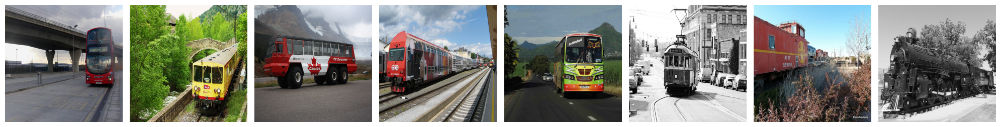

Topic ID: 1 : ['cat', 'dog', 'laying', 'top', 'bear', 'black', 'teddy', 'bed', 'white', 'sitting']
torch.Size([10, 512])


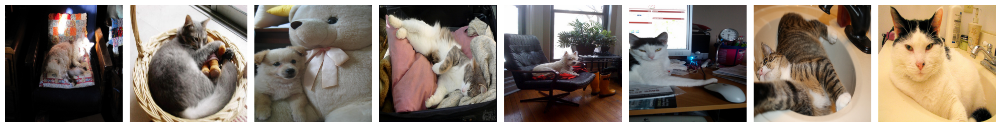

Topic ID: 2 : ['vase', 'table', 'flowers', 'cake', 'filled', 'food', 'eating', 'glass', 'wine', 'bowl']
torch.Size([10, 512])


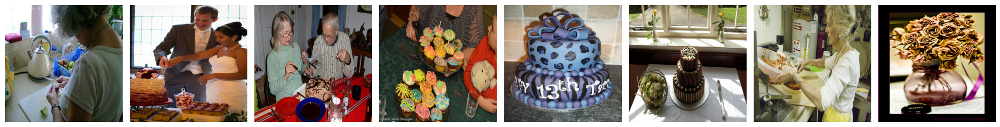

Topic ID: 3 : ['cake', 'table', 'cutting', 'food', 'bananas', 'vegetables', 'bowl', 'chocolate', 'plates', 'counter']
torch.Size([10, 512])


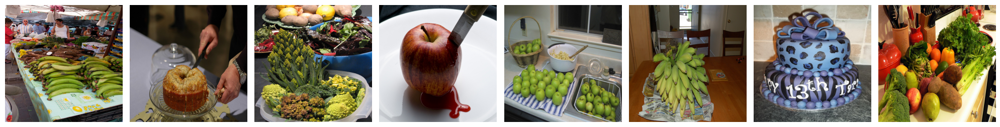

Topic ID: 4 : ['sign', 'building', 'clock', 'stop', 'street', 'tower', 'signs', 'fire', 'traffic', 'hydrant']
torch.Size([10, 512])


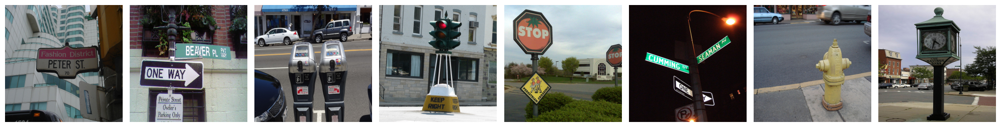

Topic ID: 5 : ['fork', 'sandwich', 'sandwiches', 'plate', 'topped', 'carrots', 'pizza', 'slices', 'pan', 'cheese']
torch.Size([10, 512])


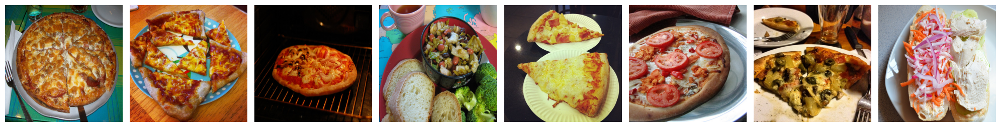

Topic ID: 6 : ['tennis', 'ball', 'player', 'baseball', 'court', 'playing', 'racquet', 'game', 'racket', 'holding']
torch.Size([10, 512])


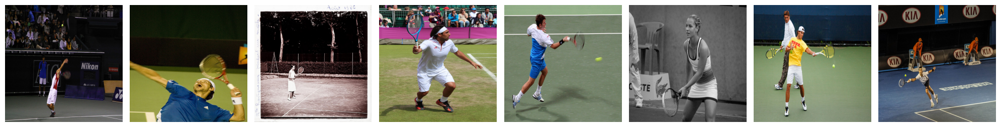

Topic ID: 7 : ['hot', 'vegetables', 'donuts', 'plates', 'piece', 'pizza', 'topped', 'food', 'plate', 'salad']
torch.Size([10, 512])


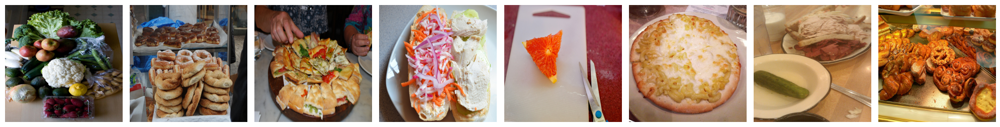

Topic ID: 8 : ['wine', 'cake', 'glasses', 'woman', 'cutting', 'eating', 'donut', 'vase', 'flowers', 'glass']
torch.Size([10, 512])


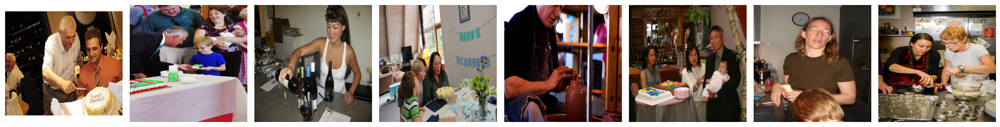

Topic ID: 9 : ['baseball', 'ball', 'tennis', 'playing', 'player', 'frisbee', 'game', 'field', 'young', 'court']
torch.Size([10, 512])


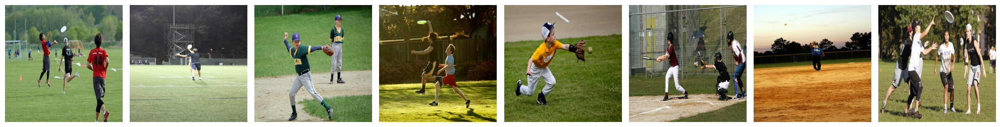

Topic ID: 10 : ['sink', 'room', 'bathroom', 'kitchen', 'living', 'desk', 'toilet', 'computer', 'mirror', 'refrigerator']
torch.Size([10, 512])


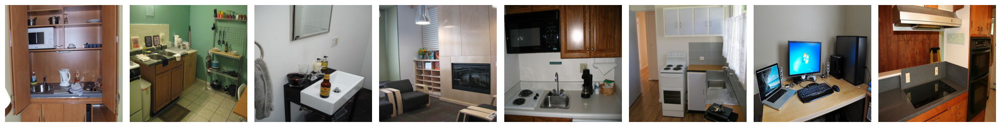

Topic ID: 11 : ['bear', 'cat', 'dog', 'horse', 'laying', 'black', 'bird', 'sheep', 'brown', 'horses']
torch.Size([10, 512])


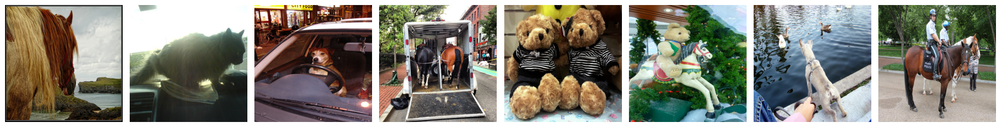

Topic ID: 12 : ['bathroom', 'toilet', 'room', 'sink', 'white', 'living', 'bed', 'wall', 'small', 'mirror']
torch.Size([10, 512])


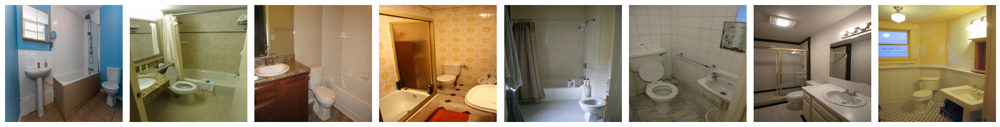

Topic ID: 13 : ['umbrella', 'phone', 'hydrant', 'fire', 'tie', 'cell', 'wearing', 'holding', 'man', 'sidewalk']
torch.Size([10, 512])


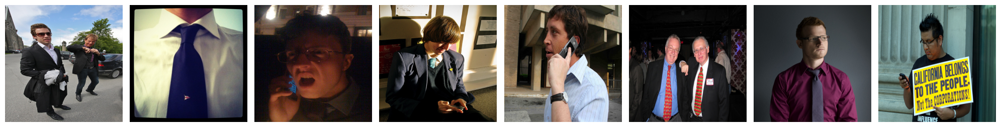

Topic ID: 14 : ['flying', 'airplane', 'plane', 'sky', 'airport', 'jet', 'large', 'air', 'runway', 'kite']
torch.Size([10, 512])


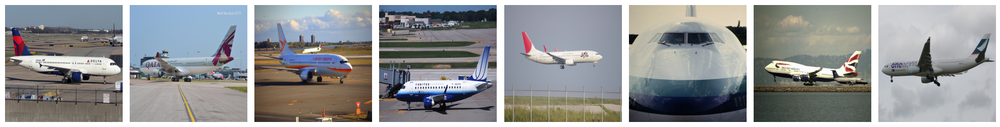

Topic ID: 15 : ['kitchen', 'refrigerator', 'vase', 'computer', 'laptop', 'flowers', 'glasses', 'wii', 'woman', 'wine']
torch.Size([10, 512])


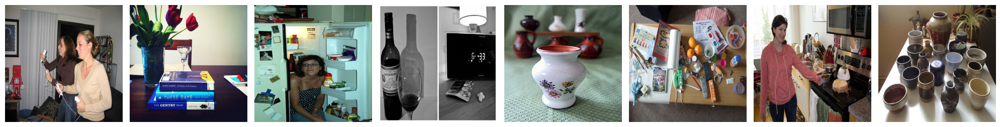

Topic ID: 16 : ['laptop', 'wii', 'phone', 'wall', 'computer', 'couch', 'bed', 'cell', 'tie', 'sitting']
torch.Size([10, 512])


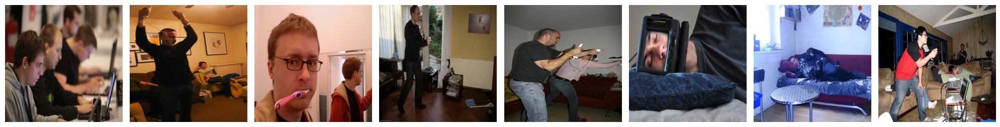

Topic ID: 17 : ['train', 'motorcycle', 'traveling', 'city', 'truck', 'bus', 'cars', 'parked', 'tracks', 'driving']
torch.Size([10, 512])


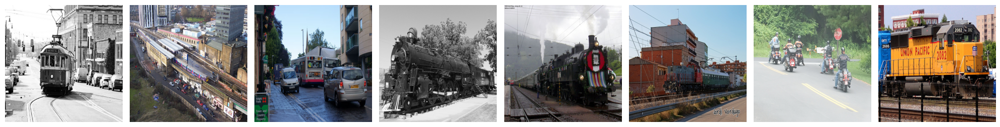

Topic ID: 18 : ['beach', 'water', 'boat', 'boats', 'ocean', 'kite', 'surfboard', 'flying', 'kites', 'body']
torch.Size([10, 512])


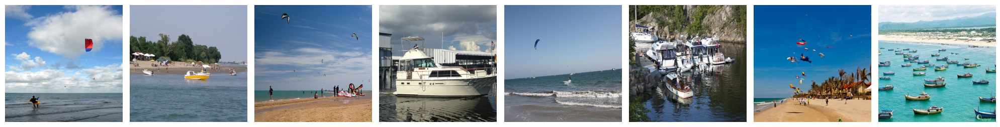

Topic ID: 19 : ['riding', 'skateboard', 'wave', 'snow', 'skis', 'board', 'surfboard', 'man', 'surfer', 'ramp']
torch.Size([10, 512])


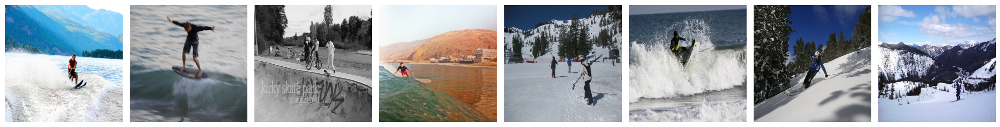

Topic ID: 20 : ['giraffe', 'elephant', 'standing', 'elephants', 'cows', 'sheep', 'grass', 'two', 'bird', 'herd']
torch.Size([10, 512])


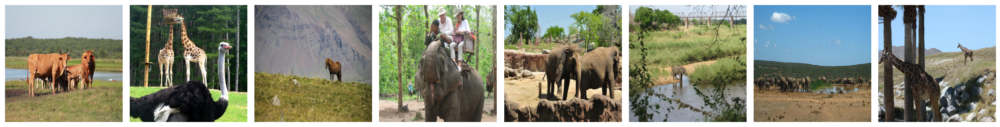

Topic ID: 21 : ['tennis', 'ball', 'court', 'baseball', 'player', 'racquet', 'playing', 'game', 'racket', 'dog']
torch.Size([10, 512])


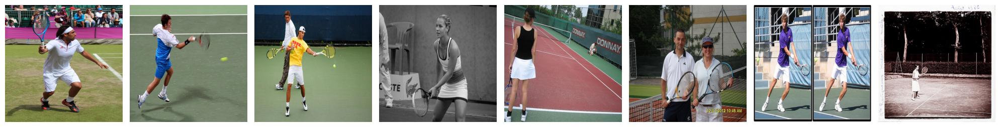

Topic ID: 22 : ['snow', 'skateboard', 'riding', 'skis', 'slope', 'person', 'covered', 'wave', 'board', 'man']
torch.Size([10, 512])


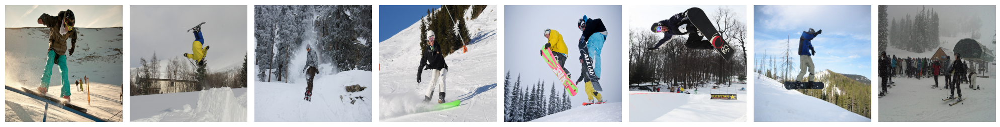

Topic ID: 23 : ['giraffe', 'zebra', 'elephant', 'giraffes', 'grass', 'elephants', 'standing', 'zebras', 'zoo', 'field']
torch.Size([10, 512])


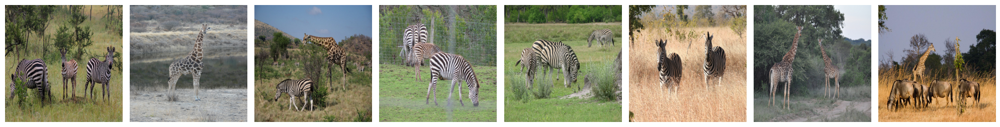

Topic ID: 24 : ['plate', 'pizza', 'sandwich', 'topped', 'cheese', 'broccoli', 'meat', 'salad', 'slices', 'vegetables']
torch.Size([10, 512])


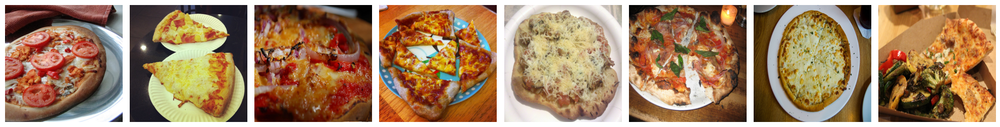

In [7]:
from PIL import Image
import torch

# Initialize a list to store term embeddings for each topic
term_list = []

# Iterate over the range of current number of topics
for current_topic_id in range(current_number_of_topics):
    # Print the topic ID and the top 10 terms for the current topic
    print('Topic ID:', str(current_topic_id), ':', m3l_contrast.get_topic_lists(10)[current_topic_id]) # Language ID = 0
    
    # Get the indices of the top documents for the current topic
    current_list_indices = (-training_doc_topic_distributions).argsort(axis=0).T[current_topic_id]
    
    # Get the top image embeddings for the current topic
    closest_image_embeddings = m3l_contrast.get_top_image_embeddings(current_topic_id, training_doc_topic_distributions, top_n=10)
    print(closest_image_embeddings.shape)
    
    # Append the closest image embeddings to the term list
    term_list.append(closest_image_embeddings)
    
    # Convert the closest image embeddings to a tensor
    closest_image_embeddings = torch.Tensor(closest_image_embeddings)
    
    # Display the most relevant images for the current topic
    show_most_relevant_images_per_topic(
        current_topic_id,
        column_name_image_path,
        column_text_name,
        training_doc_topic_distributions,
        df,
        current_list_indices,
        topn=8
    )

# Code for getting the most relevant images ends here
